In [1]:
!pip install pretrainedmodels
!pip install imutils
!gdown 137RyRjvTBkBiIfeYBNZBtViDHQ6_Ewsp

Downloading...
From (original): https://drive.google.com/uc?id=137RyRjvTBkBiIfeYBNZBtViDHQ6_Ewsp
From (redirected): https://drive.google.com/uc?id=137RyRjvTBkBiIfeYBNZBtViDHQ6_Ewsp&confirm=t&uuid=e5aca124-9de9-400a-b1b9-048972947345
To: /content/101_ObjectCategories.tar.gz
100% 132M/132M [00:01<00:00, 121MB/s]


### Частина 0 - Завантаження і препроцесінг датасету

In [2]:
import matplotlib.pyplot as plt
import joblib
import cv2
import os
import time
import random
import pretrainedmodels
import numpy as np
from sklearn.preprocessing import LabelEncoder
from imutils import paths
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.models as models
from torchvision.models import ResNet18_Weights
from torch.nn import functional as F
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from PIL import Image
import tarfile
import math
import seaborn as sns
from sklearn.preprocessing import label_binarize

### Датасет Caltech101 завантажимо і розпакуємо в локальну директорію

In [3]:
dataset_path = './101_ObjectCategories.tar.gz'
extracted_folder_path = './Caltech101Dataset/'
if not os.path.exists(extracted_folder_path + '101_ObjectCategories'):
    with tarfile.open(dataset_path, 'r:gz') as tar:
        tar.extractall(extracted_folder_path)


### Для отриманої директорії в яку був розархівований датасет було додано 102 папки з різними фотографіями, які відностяться до різних категорій, тому аби можна було ці фотографії перетворити на дані/тензори для навчання подальших моделей відповідно до завдання, завантажимо їх усіх, та як класи до яких відносяться ці фотографії возьмемо назви директорій, а відповідно безпосередніми даними будуть самі фотографії. Також слід зазначити, що директорія BACKGROUND_Google містить різні фотографії які не належать до одного й того ж класу, тому її ми пропустимо при завантаженні даних і відповідно матимемо 101 клас, а також оскільки деякі з зображень є чорно-білими і мають лише один канал, а при роботі нам знадобиться 3, то перетворимо усі зображення у формат RGB, та задамо їм усім сталий розмір через бібліотеку OpenCV

In [4]:
image_paths = list(paths.list_images('./Caltech101Dataset/101_ObjectCategories'))

data = []
labels = []
for img_path in tqdm(image_paths):
    label = img_path.split(os.path.sep)[-2]
    if label == "BACKGROUND_Google":
        continue
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (224, 224))

    data.append(img)
    labels.append(label)

data = np.array(data)
labels = np.array(labels)

print("Data shape:", data.shape)
print("Labels shape:", labels.shape)

100%|██████████| 9144/9144 [00:22<00:00, 400.95it/s] 


Data shape: (8677, 224, 224, 3)
Labels shape: (8677,)


### Отже в результаті ми отримали 8677 зображень. Тепер оскільк нейронні мережі краще працють з числами а не з строковим текстом, перетворимо усі назви класів у відповідні числові представлення через Label-Encoding

In [5]:
num_of_classes = LabelEncoder()
labels = num_of_classes.fit_transform(labels)
print(f"Total Number of Classes: {len(num_of_classes.classes_)}")

Total Number of Classes: 101


### Отримані дані тепер можемо розділити на навчальні і тестові, для цього скористаємося функцією sklearn train_test_split, і відповідно розділимо дані у співвідношенні 70/30

In [6]:
x_train, x_test, y_train, y_test = train_test_split(data, labels, train_size=0.7)
print(f"X_train: {len(x_train)}  X_test: {len(x_test)}")

X_train: 6073  X_test: 2604


### Тепер оскільки дані треба представити як тензори для нормальної роботи моделі при навчанні і оцінці, створимо власний клас для трансформації зображень представлених в numpy масиві у тензори

In [7]:
class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx]
        label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        return image, label

### Під час трансформації окрім перетворення в тензори, дані аби мати можливість їх за потреби виводити на екран представимо як PILImage, а також нормалізуємо та стандартизуємо значення кольорів по усіх 3ох каналах RGB для отриманих даних

In [8]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean = [0.485,0.456,0.406], std=[0.229,0.224,0.225]),
])

### Тепер безпосередньо перетворимо дані в тензори та завантажимо їх у DataLoader-ри, значення batch_size поставимо рівне 32, а кількість епох, які будуть використовуватися для подальшого навчання моделей 50

In [9]:
batch_size=32
epoch = 50

train_dataset = CustomDataset(x_train, y_train, transform)
test_dataset = CustomDataset(x_test, y_test, transform)

trainloader = DataLoader(train_dataset, batch_size=32, shuffle=True)
testloader = DataLoader(test_dataset, batch_size=32, shuffle=False)

### Тепер ми маємо підготовлені дані і можемо приступати до проектування/навчання/валідації моделей відповідно до завдання

### Частина 1 - Створення/Навчання/Валідація моделей CNN, Resnet-frozen, Resnet-tuned

1.1 Створимо нову CNN модель, з 3-ма конвуляційними шарами та нормалізаціюю шарів через BatchNorm, при чому усього буде наявно 3 конвулюційних шари та 3 лінійних, і оскільки у нас задача класифікації зображень, то відповідно останній шар буде мати 101 вихідну ознаку оскільки всього в даному датасеті 101 клас фотографій

In [10]:
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.rl = nn.ReLU()
        self.mpool1 = nn.MaxPool2d(2)

        self.conv2 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.rl2 = nn.ReLU()
        self.mpool2 = nn.MaxPool2d(2)

        self.conv3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm2d(64)
        self.rl3 = nn.ReLU()
        self.mpool3 = nn.MaxPool2d(2)

        self.dropout1 = nn.Dropout(0.12)
        self.dropout2 = nn.Dropout(0.24)
        self.dropout3 = nn.Dropout(0.48)

        self.fc1 = nn.Linear(64 * 28 * 28, 512)
        self.bn4 = nn.BatchNorm1d(512)
        self.rl4 = nn.ReLU()

        self.fc2 = nn.Linear(512, 256)
        self.bn5 = nn.BatchNorm1d(256)
        self.rl5 = nn.ReLU()

        self.fc3 = nn.Linear(256, len(num_of_classes.classes_))


    def forward(self, x):
        x =  self.mpool1(self.rl(self.bn1(self.conv1(x))))
        x =  self.mpool2(self.rl2(self.bn2(self.conv2(x))))
        x =  self.mpool3(self.rl3(self.bn3(self.conv3(x))))

        x = torch.flatten(x, 1)
        x = self.dropout1(x)

        x = self.dropout2(self.rl4(self.bn4(self.fc1(x))))
        x = self.dropout3(self.rl5(self.bn5(self.fc2(x))))

        x = self.fc3(x)

        return F.sigmoid(x)

### Навчимо отриману модель 3-ох шарової CNN, та одразу проведемо оцінку accurancy та втрат на отриманих тензорах з датасету, та запишимо ваги моделі при навчанні у спеціальний, розроблений для збергіання метрик, файл з розширенням .pth. Як оптимізатор значень для backpropagation використаємо Adam, оскільки з досвіду попередньої лабораторної роботи можемо сказати, що він завжди відносно монотонно і швидко наближає ваги моделі до оптимальних значень в нейронних мережах, відповідно для нього learning rate поставимо 0.0001, та функцією втрат, оскільки перед нами стоїть задача класифікації використаємо CrossEntropyLoss, яка безпосередньо презначена для задач багатовимірної класифікації і ідеально підійде для нашого випадку. Кількість епох для CNN моделі та й для усіх наступних - 50

In [11]:
def train_validate_model(model, train_loader, test_loader, criterion, optimizer, type, epochs=10):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    train_losses = []
    test_losses = []
    train_accuracies = []
    test_accuracies = []
    train_predicted = []
    train_target = []
    test_predicted = []
    test_target = []
    early_stopping_iteration = 0

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        for inputs, labels in trainloader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

            _, predicted = torch.max(outputs, 1)
            train_predicted.extend(predicted.cpu().numpy())
            train_target.extend(labels.cpu().numpy())

        train_loss = running_loss / len(trainloader)
        train_losses.append(train_loss)


        model.eval()
        correct = 0
        total = 0
        test_loss = 0.0
        with torch.no_grad():
            for inputs, labels in testloader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                test_loss += loss.item()
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

                test_predicted.extend(predicted.cpu().numpy())
                test_target.extend(labels.cpu().numpy())

        test_loss /= len(testloader)
        test_losses.append(test_loss)

        train_accuracy = accuracy_score(train_target, train_predicted)
        test_accuracy = accuracy_score(test_target, test_predicted)

        train_accuracies.append(train_accuracy)
        test_accuracies.append(test_accuracy)

        print(f"Epoch {epoch+1}/{epochs}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f},"
         f' Train Accuracy: {train_accuracy* 100:.2f}%, Test Accuracy: {test_accuracy* 100:.2f}%')

    metrics = {
        'train_losses': train_losses,
        'test_losses': test_losses,
        'train_accuracies': train_accuracies,
        'test_accuracies': test_accuracies,
        'train_predicted': train_predicted,
        'train_target': train_target,
        'test_predicted': test_predicted,
        'test_target': test_target
    }

    if type == 'frozen':
      torch.save(metrics, 'metrics_resnet_frozen.pth')
    elif type == 'tuned':
      torch.save(metrics, 'metrics_resnet_tuned.pth')
    else:
      torch.save(metrics, 'metricsCNN.pth')

In [12]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [13]:
model = CNN().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()
train_validate_model(model, trainloader, testloader, criterion, optimizer, 'cnn', epoch)

Epoch 1/50, Train Loss: 4.4124, Test Loss: 4.3248, Train Accuracy: 30.58%, Test Accuracy: 41.94%
Epoch 2/50, Train Loss: 4.2628, Test Loss: 4.2487, Train Accuracy: 36.88%, Test Accuracy: 44.16%
Epoch 3/50, Train Loss: 4.1608, Test Loss: 4.1862, Train Accuracy: 41.85%, Test Accuracy: 46.02%
Epoch 4/50, Train Loss: 4.0697, Test Loss: 4.1664, Train Accuracy: 47.28%, Test Accuracy: 47.42%
Epoch 5/50, Train Loss: 3.9910, Test Loss: 4.1359, Train Accuracy: 52.98%, Test Accuracy: 48.72%
Epoch 6/50, Train Loss: 3.9206, Test Loss: 4.1208, Train Accuracy: 58.47%, Test Accuracy: 49.92%
Epoch 7/50, Train Loss: 3.8642, Test Loss: 4.1156, Train Accuracy: 63.40%, Test Accuracy: 50.73%
Epoch 8/50, Train Loss: 3.8190, Test Loss: 4.0953, Train Accuracy: 67.55%, Test Accuracy: 51.55%
Epoch 9/50, Train Loss: 3.7835, Test Loss: 4.0899, Train Accuracy: 70.94%, Test Accuracy: 52.47%
Epoch 10/50, Train Loss: 3.7542, Test Loss: 4.0851, Train Accuracy: 73.74%, Test Accuracy: 53.08%
Epoch 11/50, Train Loss: 3.73

### Візуалізуємо отримані результати для функції втрат та accurancy на навчальних та тестових даних:

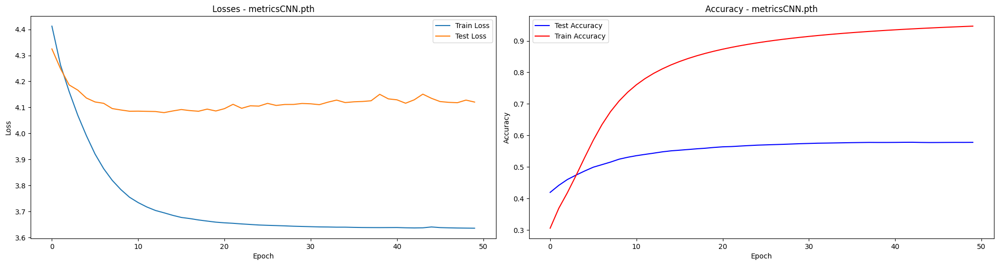

In [14]:
files = ['metricsCNN.pth']
results_data = []

for file_path in files:
    results = torch.load(file_path)
    results_data.append(results)

plt.figure(figsize=(20, 15))

for i, result in enumerate(results_data):
    plt.subplot(3, 2, i * 2 + 1)
    plt.plot(result['train_losses'], label='Train Loss')
    plt.plot(result['test_losses'], label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Losses - {files[i]}')
    plt.legend()

    plt.subplot(3, 2, i * 2 + 2)
    plt.plot(result['test_accuracies'], label='Test Accuracy', color='b')
    plt.plot(result['train_accuracies'], label='Train Accuracy', color='r')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title(f'Accuracy - {files[i]}')
    plt.legend()

plt.tight_layout()
plt.show()

### Із отриманих результатів бачимо, що точність класифікації для тестових даних рівна 58%, а на навчальних 94%, що свідчить про те що навіть застосувавши Batch нормалізацію присутній певний оверфіт на навчальних даних. При чому такий доволі низький показник класифікації на тестових даних зумовлений архітектурою CNN, оскільки вона складається лише в даному випадку з 3ох шарів з фільрами розмірності 3, що не може давати нам більшу точність класифікаці на скільки би епох не збільшували час навчання, можливо збільшити точність класифікації лише при зміні і покращенні параметрів мережі і вибору кращих активаційних функцій, але все одно 3ох шарів в даному випадку буде замало, і вибір цих параметрів покращить точність на тестови даних не більше ніж на 5-7%.

### 1.2 Тепер створимо модель frozen pre-trained ResNet та натринуємо і протестуємо її  

In [15]:
resnet = models.resnet18(weights=ResNet18_Weights.DEFAULT)
for param in resnet.parameters():
    param.requires_grad = False
resnet.fc = nn.Linear(resnet.fc.in_features, len(num_of_classes.classes_))

class FrozenResNet(nn.Module):
    def __init__(self, resnet_model):
        super(FrozenResNet, self).__init__()
        self.resnet = resnet_model

    def forward(self, x):
        x = self.resnet(x)
        return x

In [16]:
frozen_resnet = FrozenResNet(resnet).to(device)
optimizer = optim.Adam(frozen_resnet.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()
train_validate_model(frozen_resnet, trainloader, testloader, criterion, optimizer, 'frozen', epoch)

Epoch 1/50, Train Loss: 3.8971, Test Loss: 3.3055, Train Accuracy: 18.94%, Test Accuracy: 28.76%
Epoch 2/50, Train Loss: 2.9192, Test Loss: 2.5402, Train Accuracy: 27.56%, Test Accuracy: 37.10%
Epoch 3/50, Train Loss: 2.2831, Test Loss: 2.0410, Train Accuracy: 36.42%, Test Accuracy: 44.91%
Epoch 4/50, Train Loss: 1.8350, Test Loss: 1.6538, Train Accuracy: 44.31%, Test Accuracy: 51.49%
Epoch 5/50, Train Loss: 1.5113, Test Loss: 1.3989, Train Accuracy: 50.79%, Test Accuracy: 56.51%
Epoch 6/50, Train Loss: 1.2703, Test Loss: 1.1997, Train Accuracy: 55.97%, Test Accuracy: 60.65%
Epoch 7/50, Train Loss: 1.0883, Test Loss: 1.0413, Train Accuracy: 60.32%, Test Accuracy: 63.91%
Epoch 8/50, Train Loss: 0.9480, Test Loss: 0.9232, Train Accuracy: 63.80%, Test Accuracy: 66.56%
Epoch 9/50, Train Loss: 0.8325, Test Loss: 0.8448, Train Accuracy: 66.72%, Test Accuracy: 68.85%
Epoch 10/50, Train Loss: 0.7422, Test Loss: 0.7665, Train Accuracy: 69.21%, Test Accuracy: 70.80%
Epoch 11/50, Train Loss: 0.66

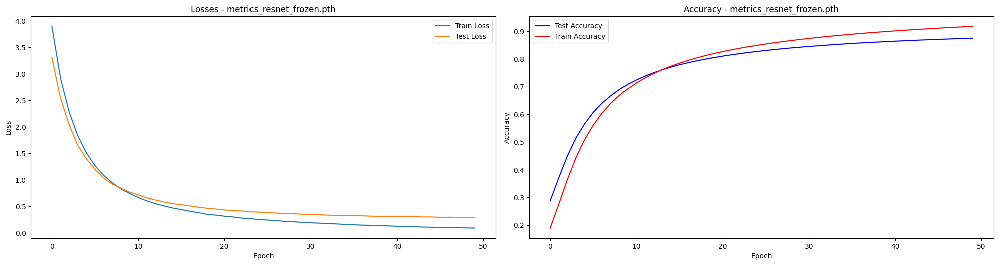

In [17]:
files = ['metrics_resnet_frozen.pth']
results_data = []

for file_path in files:
    results = torch.load(file_path)
    results_data.append(results)

plt.figure(figsize=(20, 15))

for i, result in enumerate(results_data):
    plt.subplot(3, 2, i * 2 + 1)
    plt.plot(result['train_losses'], label='Train Loss')
    plt.plot(result['test_losses'], label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Losses - {files[i]}')
    plt.legend()

    plt.subplot(3, 2, i * 2 + 2)
    plt.plot(result['test_accuracies'], label='Test Accuracy', color='b')
    plt.plot(result['train_accuracies'], label='Train Accuracy', color='r')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title(f'Accuracy - {files[i]}')
    plt.legend()

plt.tight_layout()
plt.show()

### Із отриманих результатів і візуалізації фукції втрат та accurancy бачимо, що Frozen Resnet дав набагато кращі результати на тестових (87% accurancy) і навчальних даних(91% accurancy), а також відсутній оверфіт моделі.

### 1.3 І останньою моделлю для тренування візьмемо Fine-tuned pre-trained ResNet та навчимо/протестуємо його.

In [18]:
resnet_tuned = models.resnet18(weights=ResNet18_Weights.DEFAULT)
for param in resnet_tuned.parameters():
    param.requires_grad = True
resnet_tuned.fc = nn.Linear(resnet_tuned.fc.in_features, len(num_of_classes.classes_))

class FineTunedResNet(nn.Module):
    def __init__(self, resnet_model):
        super(FineTunedResNet, self).__init__()
        self.resnet = resnet_model

    def forward(self, x):
        x = self.resnet(x)
        return x

In [19]:
finetuned_resnet = FineTunedResNet(resnet_tuned).to(device)
optimizer = optim.Adam(finetuned_resnet.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()
train_validate_model(finetuned_resnet, trainloader, testloader, criterion, optimizer, 'tuned', epoch)

Epoch 1/50, Train Loss: 1.7179, Test Loss: 0.6269, Train Accuracy: 67.96%, Test Accuracy: 88.86%
Epoch 2/50, Train Loss: 0.3275, Test Loss: 0.3110, Train Accuracy: 82.32%, Test Accuracy: 91.44%
Epoch 3/50, Train Loss: 0.0911, Test Loss: 0.2319, Train Accuracy: 88.02%, Test Accuracy: 92.69%
Epoch 4/50, Train Loss: 0.0374, Test Loss: 0.2150, Train Accuracy: 90.98%, Test Accuracy: 93.30%
Epoch 5/50, Train Loss: 0.0208, Test Loss: 0.1979, Train Accuracy: 92.78%, Test Accuracy: 93.76%
Epoch 6/50, Train Loss: 0.0138, Test Loss: 0.1880, Train Accuracy: 93.98%, Test Accuracy: 94.06%
Epoch 7/50, Train Loss: 0.0101, Test Loss: 0.1812, Train Accuracy: 94.83%, Test Accuracy: 94.24%
Epoch 8/50, Train Loss: 0.0076, Test Loss: 0.1833, Train Accuracy: 95.47%, Test Accuracy: 94.37%
Epoch 9/50, Train Loss: 0.0067, Test Loss: 0.1823, Train Accuracy: 95.97%, Test Accuracy: 94.50%
Epoch 10/50, Train Loss: 0.0048, Test Loss: 0.1764, Train Accuracy: 96.37%, Test Accuracy: 94.59%
Epoch 11/50, Train Loss: 0.00

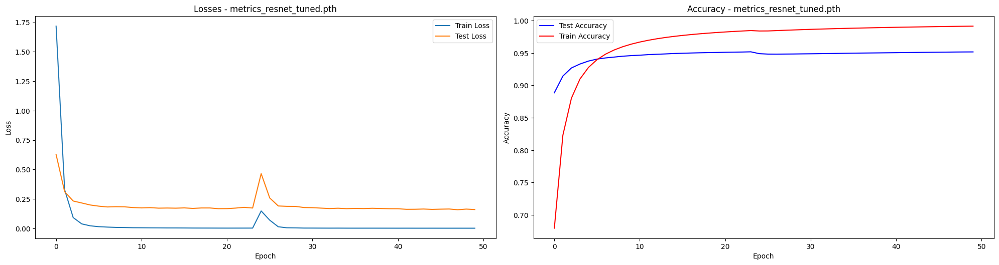

In [20]:
files = ['metrics_resnet_tuned.pth']
results_data = []

for file_path in files:
    results = torch.load(file_path)
    results_data.append(results)

plt.figure(figsize=(20, 15))

for i, result in enumerate(results_data):
    plt.subplot(3, 2, i * 2 + 1)
    plt.plot(result['train_losses'], label='Train Loss')
    plt.plot(result['test_losses'], label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Losses - {files[i]}')
    plt.legend()

    plt.subplot(3, 2, i * 2 + 2)
    plt.plot(result['test_accuracies'], label='Test Accuracy', color='b')
    plt.plot(result['train_accuracies'], label='Train Accuracy', color='r')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title(f'Accuracy - {files[i]}')
    plt.legend()

plt.tight_layout()
plt.show()

### Із отриманих результатів бачимо, що Fine-tuned pre-trained ResNet дає найкращу точність на тестових(95%) і навчальних(99%) даних з усіх 3ох наведених моделей, і не має оверфіту. Та найкращу точність досягає на 32й епосі, що свідчить про те що було лишній раз навчено модель, через що на прикінці вона почала погіршувати точність класифікації, аналогічно і з попередніми навединими моедлями, що свідчить про те, що можливо варто використовувати у таких випадках EarlyStopping

### Тепер для отриманих моделей провидемо візуалізацію і аналіз метрик

### Частина 2 Візуалізація і аналіз метрик

### 2.1 Застосоуємо sklearn. metrics.classification_report для перегляду повного звіту по класифікації кожної з метрик таких як, f1 score, precision, recall, support  для кожної з моделей


### Результат звітності для CNN з 3ма шарами

In [21]:
results = torch.load('metricsCNN.pth')
print(classification_report(results['train_target'], results['train_predicted']))
print(classification_report(results['test_target'], results['test_predicted']))

              precision    recall  f1-score   support

           0       0.87      0.99      0.92     15000
           1       0.96      0.99      0.98     15400
           2       0.94      0.99      0.97      7000
           3       0.96      1.00      0.98     27550
           4       0.96      0.94      0.95      2000
           5       0.94      1.00      0.97     28300
           6       1.00      0.89      0.94      1600
           7       0.99      0.89      0.94      1350
           8       0.99      0.89      0.94      2000
           9       0.96      0.91      0.94      2000
          10       1.00      0.88      0.94      1700
          11       0.99      0.91      0.95      1450
          12       0.86      0.97      0.91      4800
          13       0.96      0.94      0.95      3450
          14       1.00      0.90      0.94      1700
          15       0.87      0.94      0.90      2750
          16       0.92      0.94      0.93      3400
          17       1.00    

### Результат звітносіті для Frozen Resnet

In [22]:
results = torch.load('metrics_resnet_frozen.pth')
print(classification_report(results['train_target'], results['train_predicted']))
print(classification_report(results['test_target'], results['test_predicted']))

              precision    recall  f1-score   support

           0       0.87      0.94      0.90     15000
           1       0.91      0.94      0.92     15400
           2       0.92      0.99      0.95      7000
           3       0.86      1.00      0.93     27550
           4       0.99      0.94      0.97      2000
           5       0.85      0.99      0.91     28300
           6       0.97      0.72      0.83      1600
           7       0.94      0.76      0.84      1350
           8       0.99      0.90      0.94      2000
           9       0.98      0.78      0.87      2000
          10       0.91      0.86      0.89      1700
          11       0.98      0.92      0.95      1450
          12       0.92      0.96      0.94      4800
          13       0.88      0.95      0.91      3450
          14       0.91      0.76      0.83      1700
          15       0.94      0.93      0.94      2750
          16       0.88      0.88      0.88      3400
          17       0.99    

### Результат звітності для Tuned Resnet

In [23]:
results = torch.load('metrics_resnet_tuned.pth')
print(classification_report(results['train_target'], results['train_predicted']))
print(classification_report(results['test_target'], results['test_predicted']))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     15000
           1       0.99      0.99      0.99     15400
           2       0.99      1.00      1.00      7000
           3       1.00      1.00      1.00     27550
           4       1.00      0.99      1.00      2000
           5       1.00      1.00      1.00     28300
           6       0.99      0.98      0.98      1600
           7       0.99      0.97      0.98      1350
           8       0.99      0.99      0.99      2000
           9       0.99      0.98      0.99      2000
          10       0.97      0.98      0.98      1700
          11       1.00      0.98      0.99      1450
          12       0.99      1.00      0.99      4800
          13       0.99      0.99      0.99      3450
          14       1.00      0.98      0.99      1700
          15       1.00      0.99      1.00      2750
          16       0.98      0.99      0.99      3400
          17       1.00    

### 2.2 Тепер для кожної з метрик відобразимо confusion матрицю розмірності 101x101 оскільки всьо класів 101

### Cunfusion матриця для CNN з 3ма шарами

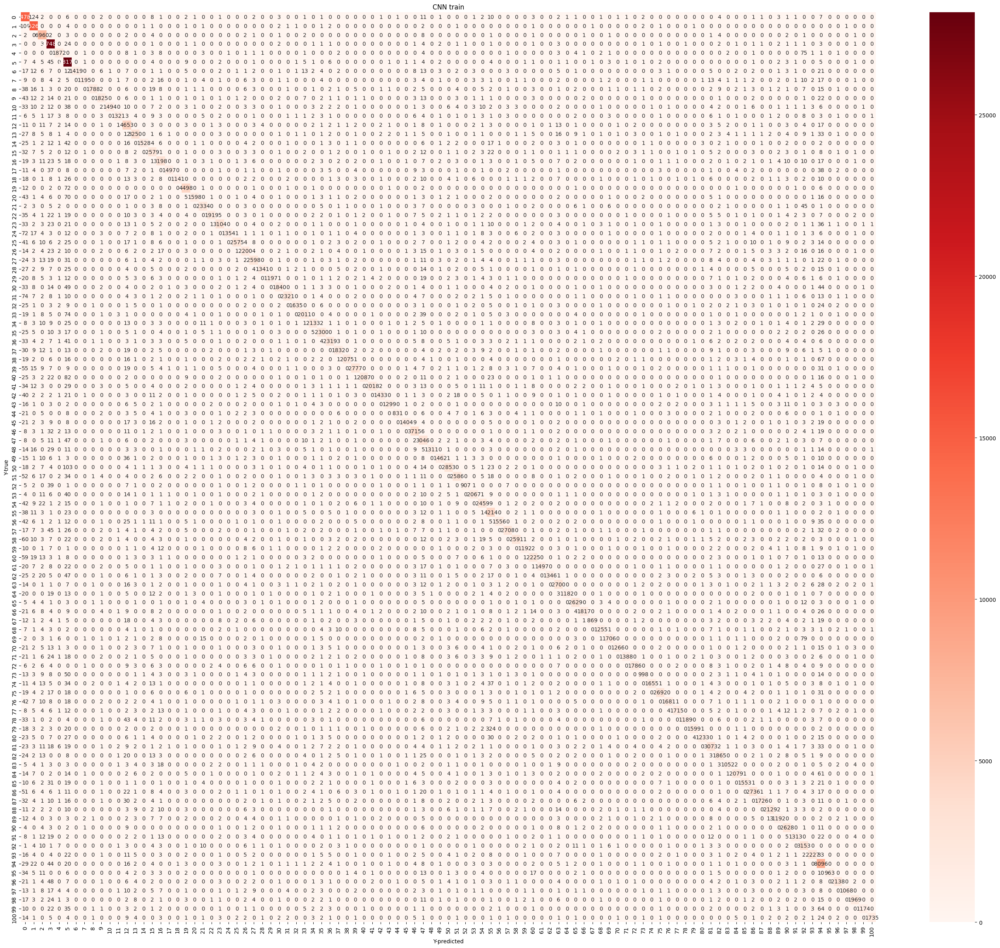

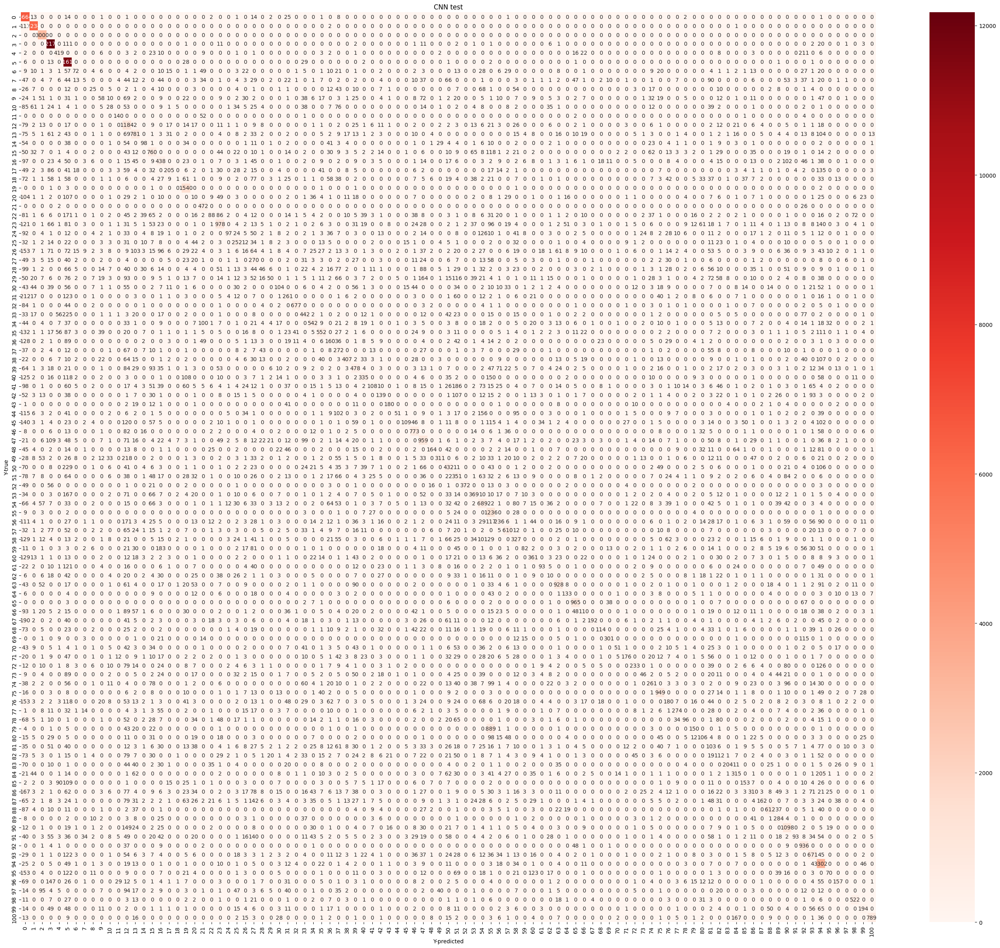

In [24]:
results = torch.load('metricsCNN.pth')
cm_train = confusion_matrix(results['train_target'], results['train_predicted'])
cm_test = confusion_matrix(results['test_target'], results['test_predicted'])

plt.figure(figsize=(35, 30))
sns.heatmap(cm_train, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("CNN train")
plt.show()

plt.figure(figsize=(35, 30))
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("CNN test")
plt.show()

### Confusion матриця для Frozen Resnet

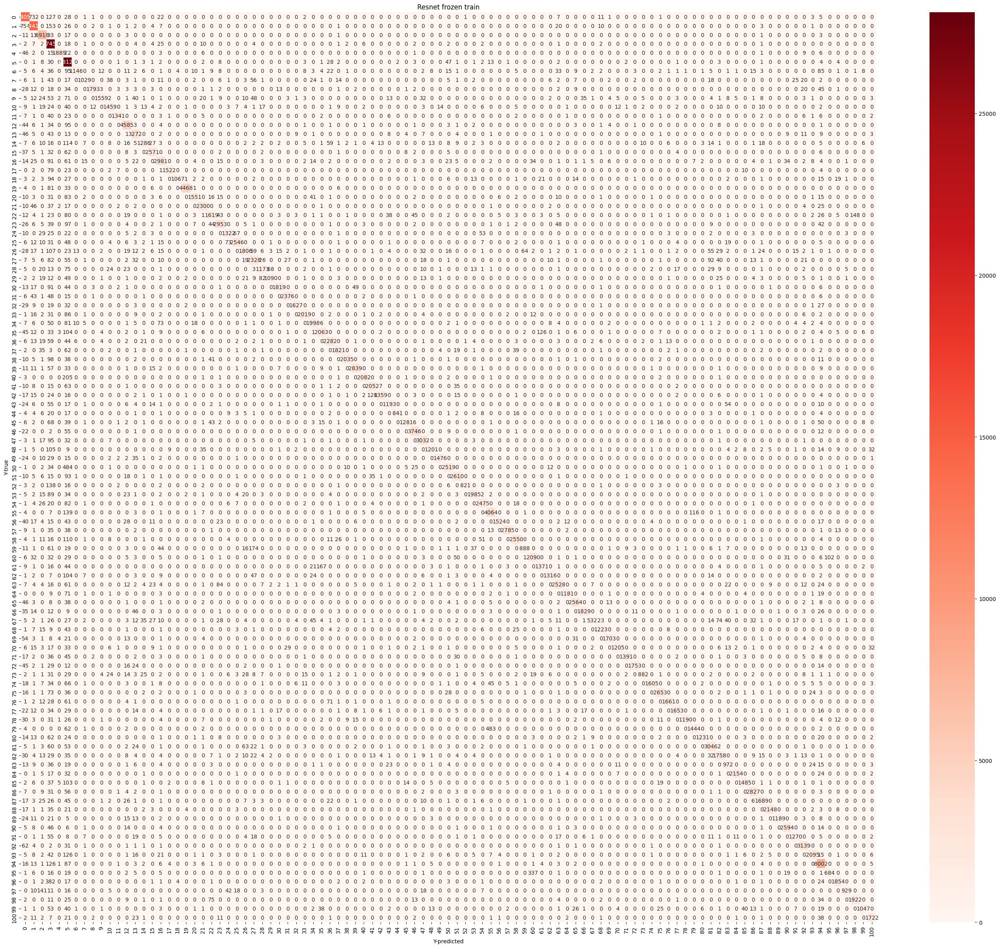

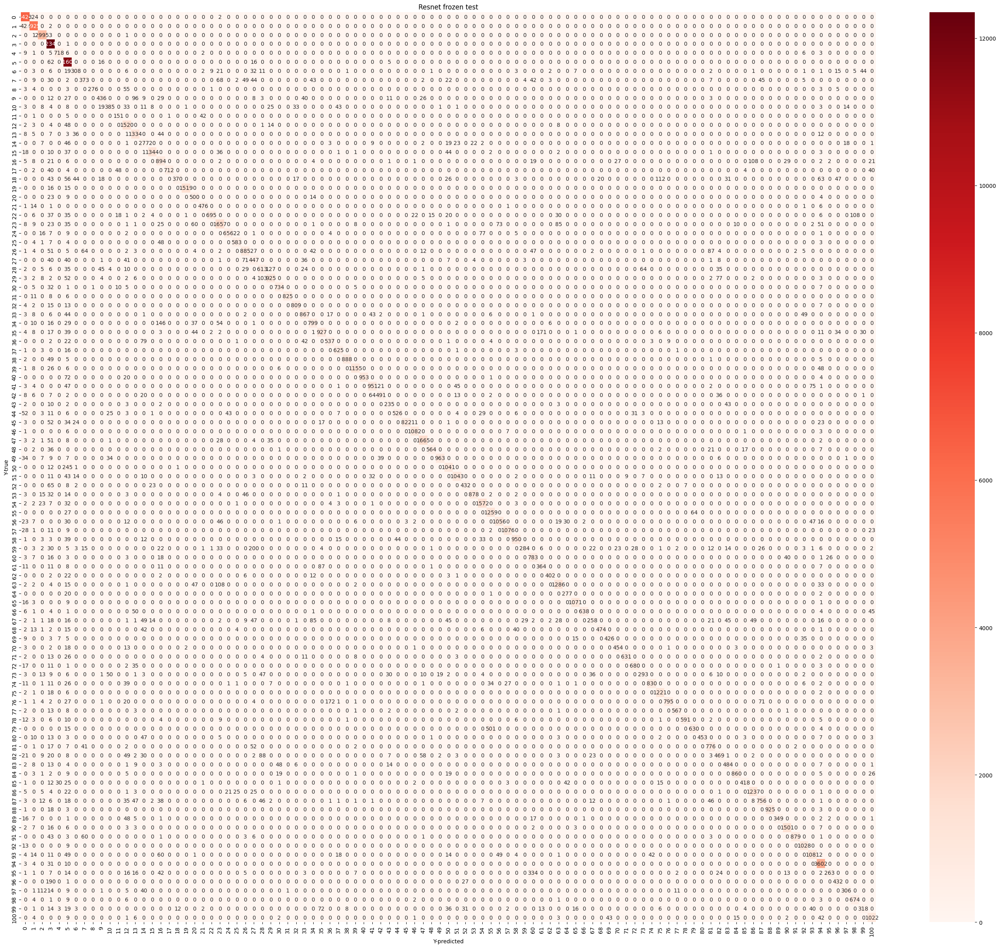

In [25]:
results = torch.load('metrics_resnet_frozen.pth')
cm_train = confusion_matrix(results['train_target'], results['train_predicted'])
cm_test = confusion_matrix(results['test_target'], results['test_predicted'])

plt.figure(figsize=(35, 30))
sns.heatmap(cm_train, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("Resnet frozen train")
plt.show()

plt.figure(figsize=(35, 30))
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("Resnet frozen test")
plt.show()

### Confusion матриця для Fine-Tuned Resnet

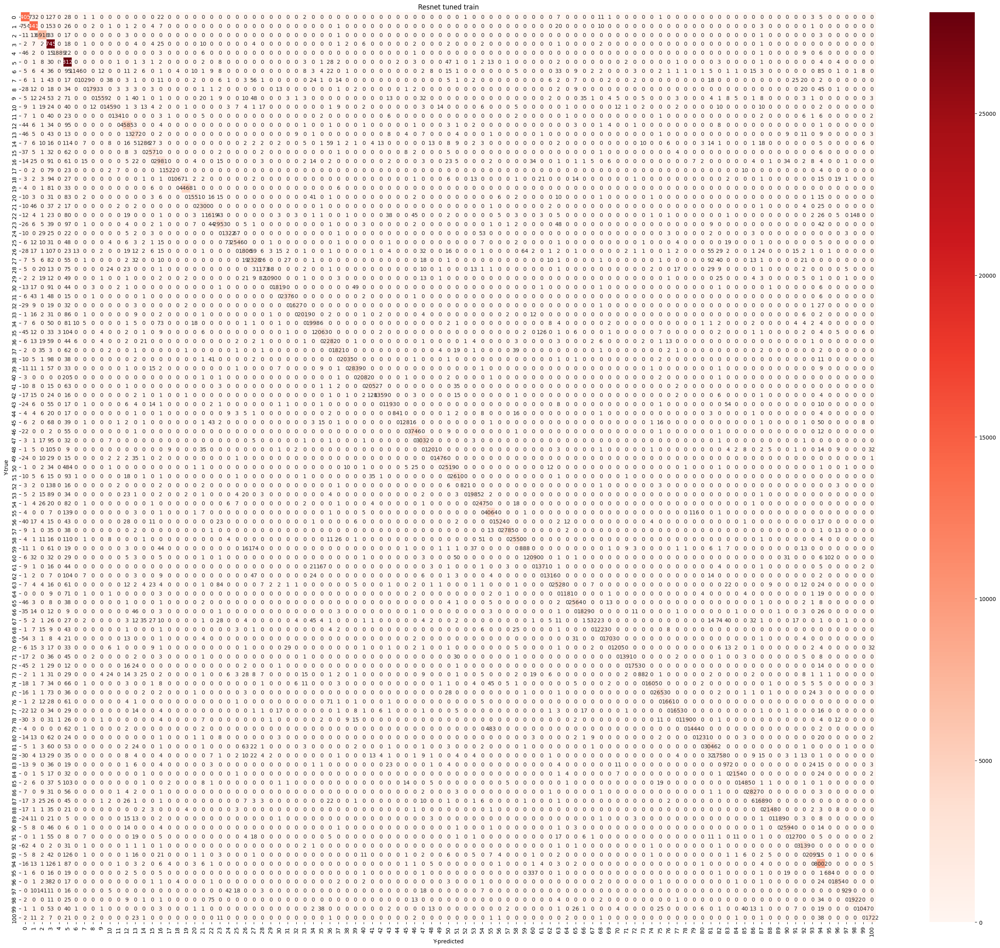

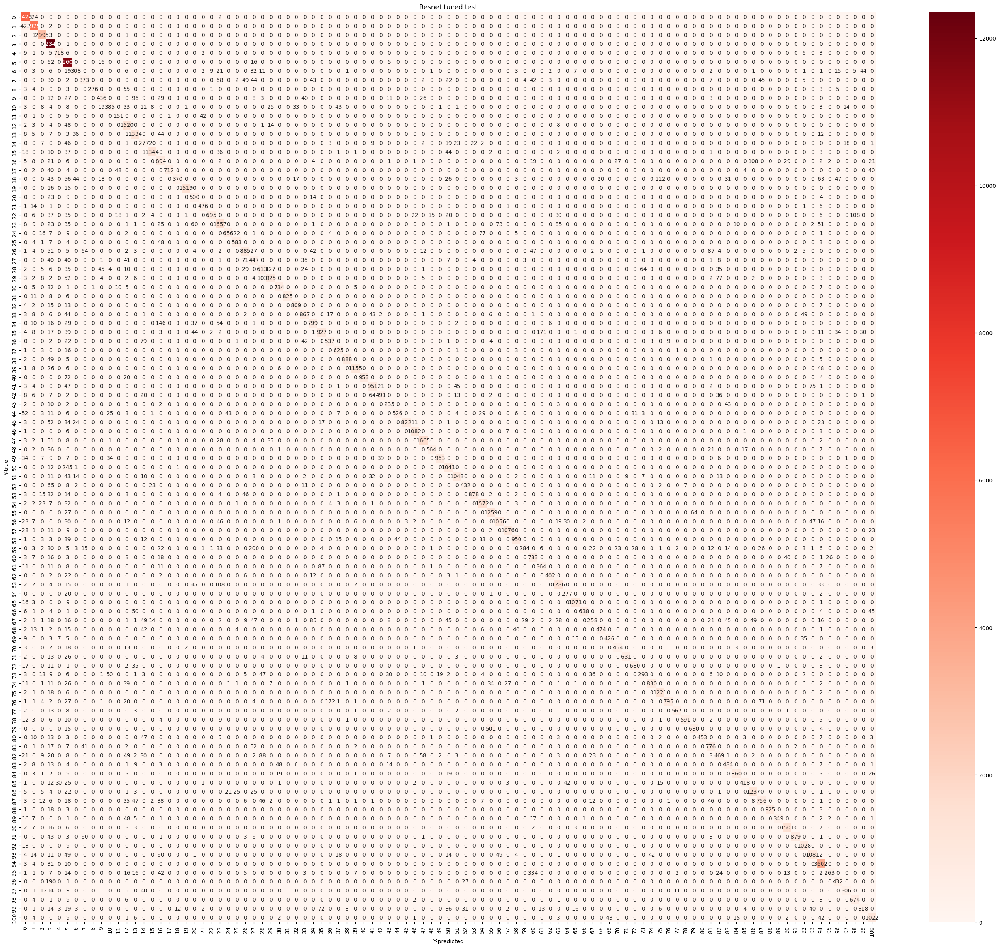

In [26]:
results = torch.load('metrics_resnet_frozen.pth')
cm_train = confusion_matrix(results['train_target'], results['train_predicted'])
cm_test = confusion_matrix(results['test_target'], results['test_predicted'])

plt.figure(figsize=(35, 30))
sns.heatmap(cm_train, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("Resnet tuned train")
plt.show()

plt.figure(figsize=(35, 30))
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Reds")
plt.xlabel("Y-predicted")
plt.ylabel("Y-true")
plt.title("Resnet tuned test")
plt.show()

### 2.3 Візууалізуємо знову усі моделі да їхні loss та accurancy на тренувальних і тестових даних

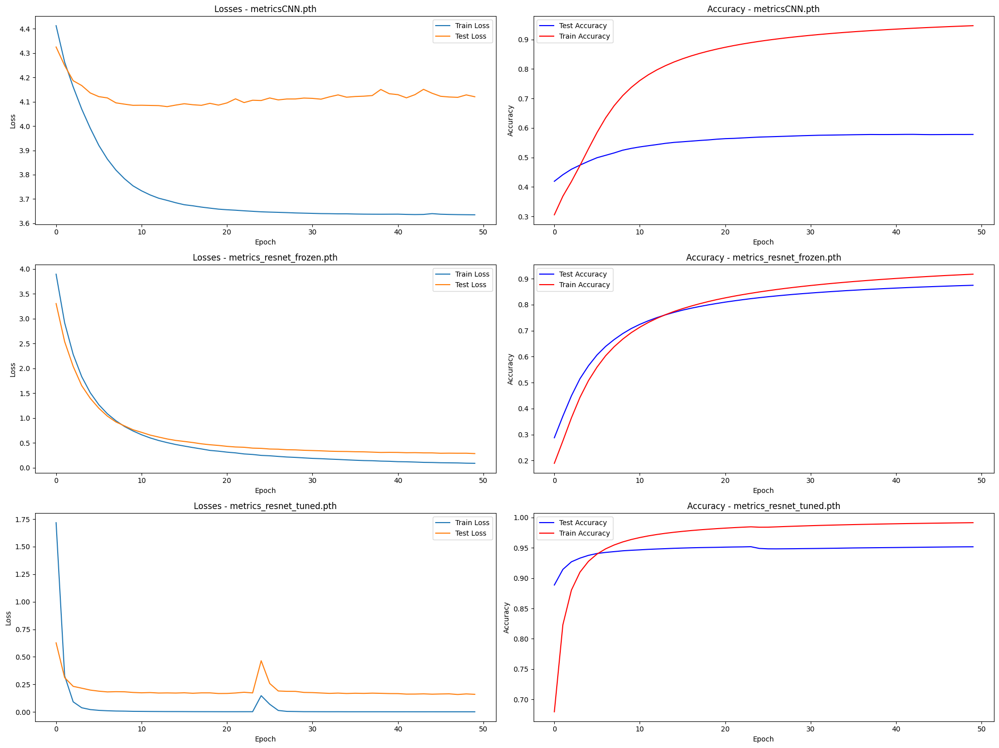

In [27]:
files = ['metricsCNN.pth', 'metrics_resnet_frozen.pth', 'metrics_resnet_tuned.pth']
results_data = []

for file_path in files:
    results = torch.load(file_path)
    results_data.append(results)

plt.figure(figsize=(20, 15))

for i, result in enumerate(results_data):
    train_losses = result['train_losses']
    test_losses = result['test_losses']
    test_accuracies = result['test_accuracies']
    train_accuracies = result['train_accuracies']

    plt.subplot(3, 2, i * 2 + 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(test_losses, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Losses - {files[i]}')
    plt.legend()

    plt.subplot(3, 2, i * 2 + 2)
    plt.plot(test_accuracies, label='Test Accuracy', color='b')
    plt.plot(train_accuracies, label='Train Accuracy', color='r')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title(f'Accuracy - {files[i]}')
    plt.legend()

plt.tight_layout()
plt.show()

### 2.4 Тепер візуалізує ROC Curve, що представляє собою графік якості бінарного класифікатора, і відповідно відображає зв'язки між True Positive Rate та False Positive Rate, чим ближче до верхнього лівого куда будуть графіки для кожного з класів, тим краще працює модель, тож запустимо і переглянемо для кожної з моделей ROC Curve plot

In [28]:
def plot_roc(input_file_path):
    results = torch.load(input_file_path)
    for oper in ['train', 'test']:
        test_predicted = torch.tensor(results[oper + '_predicted']).numpy()
        test_target = torch.tensor(results[oper + '_target']).numpy()
        test_target_bin = label_binarize(test_target, classes=range(len(set(test_target))))
        test_predicted_bin = label_binarize(test_predicted, classes=range(len(set(test_target))))

        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for i in range(len(set(test_target))):
            fpr[i], tpr[i], _ = roc_curve(test_target_bin[:, i], test_predicted_bin[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
        fpr["micro"], tpr["micro"], _ = roc_curve(test_target_bin.ravel(), test_predicted_bin.ravel())
        roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

        plt.figure(figsize=(20, 20))
        plt.plot(fpr["micro"], tpr["micro"], label=f'micro-average ROC curve (area = {roc_auc["micro"]})', color='green', linestyle=':', linewidth=6)

        for i in range(len(set(test_target))):
            plt.plot(fpr[i], tpr[i], lw=2, label=f'ROC curve of class {i} (area = {roc_auc[i]})')

        plt.plot([0, 1], [0, 1], 'k--', lw=2)
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curve' + oper)
        plt.legend(loc="best")
        plt.show()

### ROC Curve plot для CNN з 3ма шарами

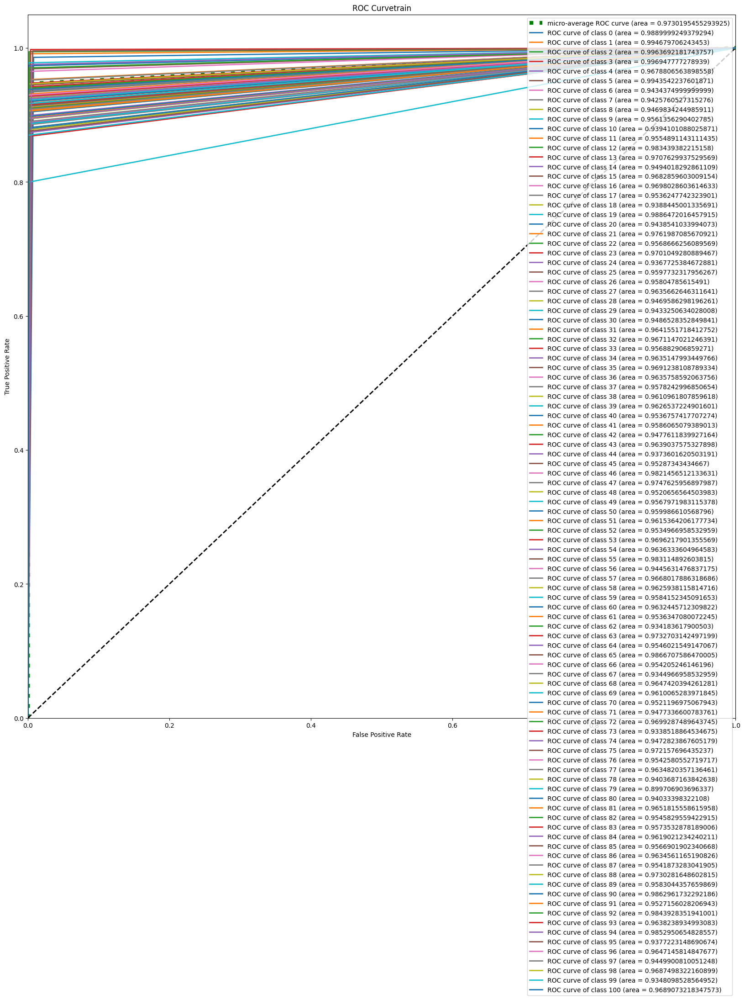

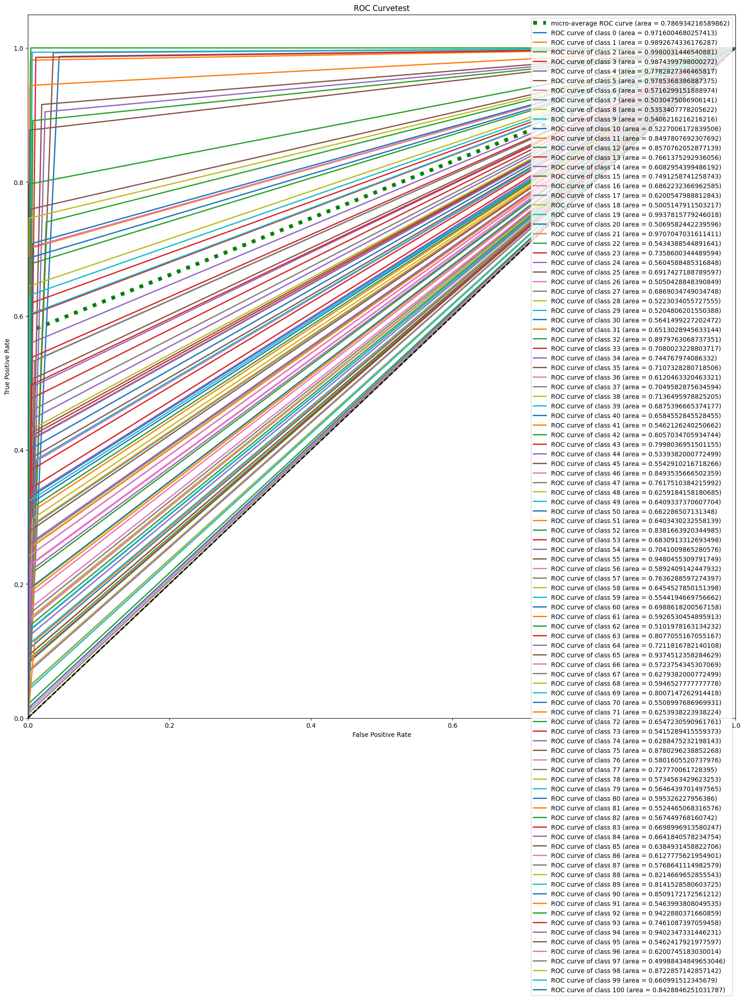

In [29]:
plot_roc('metricsCNN.pth')

### ROC Curve plot для Frozen Resnet

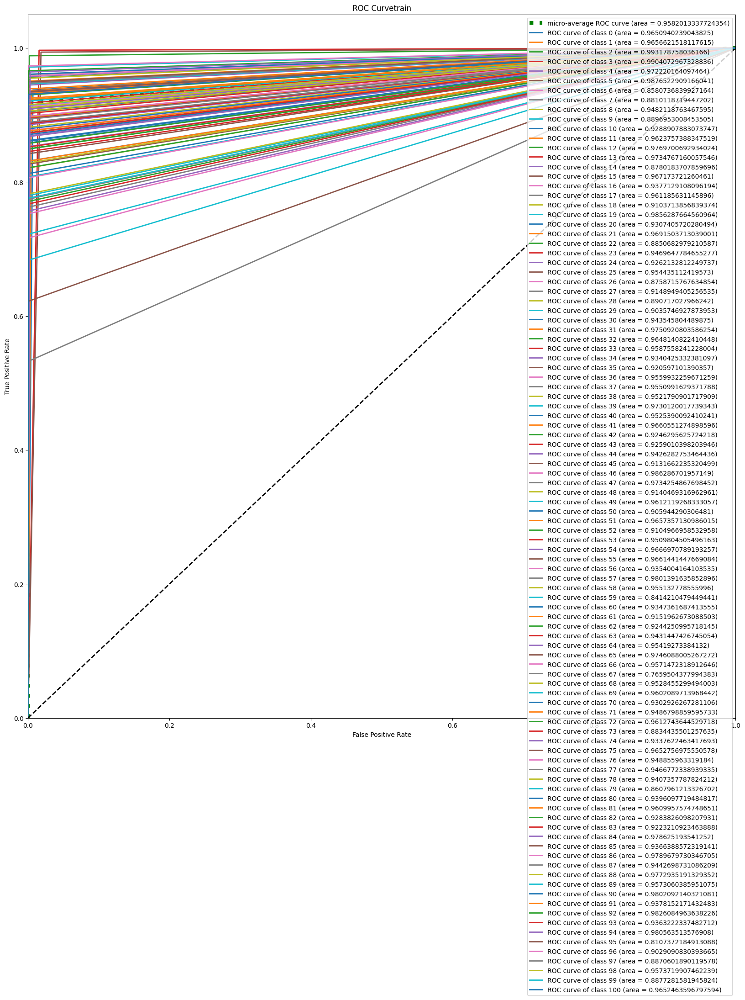

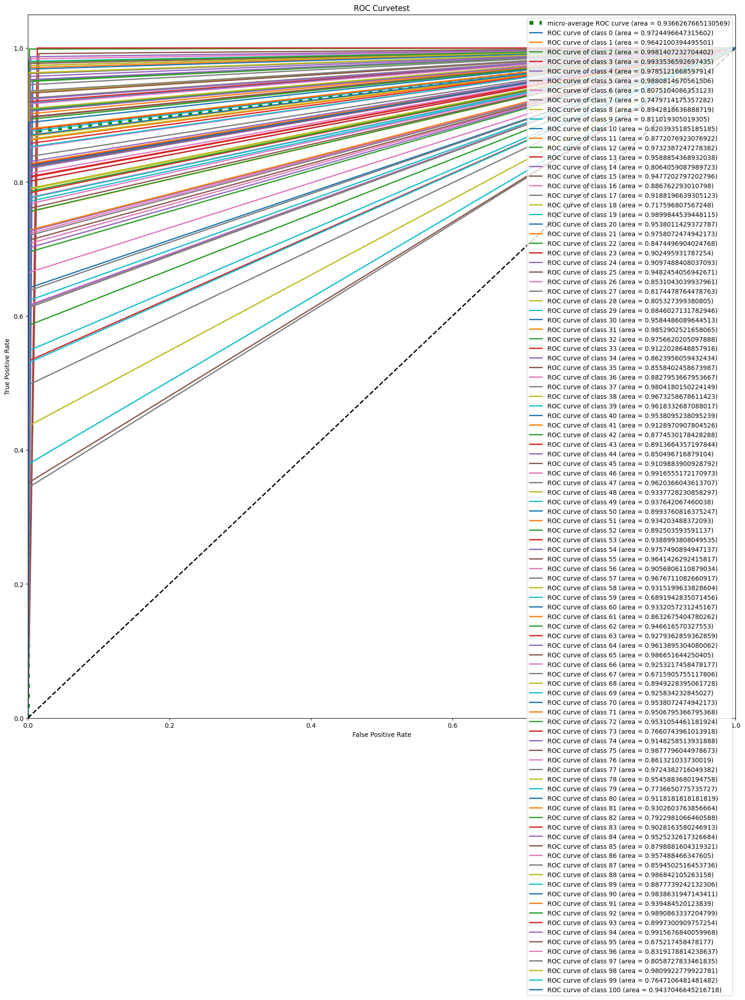

In [30]:
plot_roc('metrics_resnet_frozen.pth')

### ROC Curve plot для FineTuned Resnet

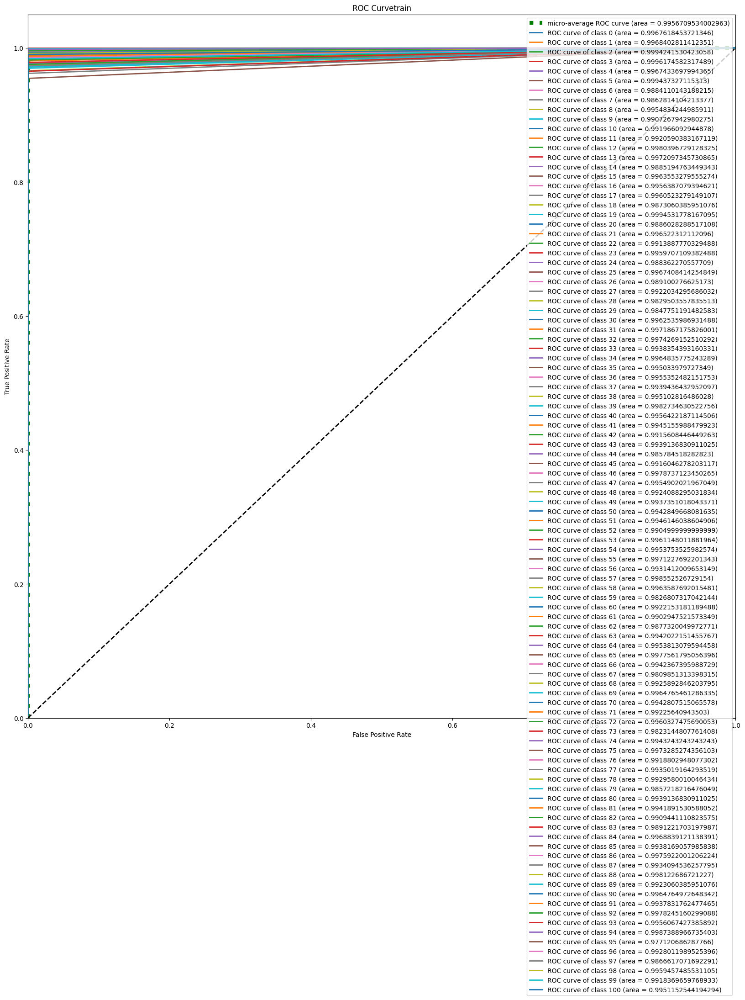

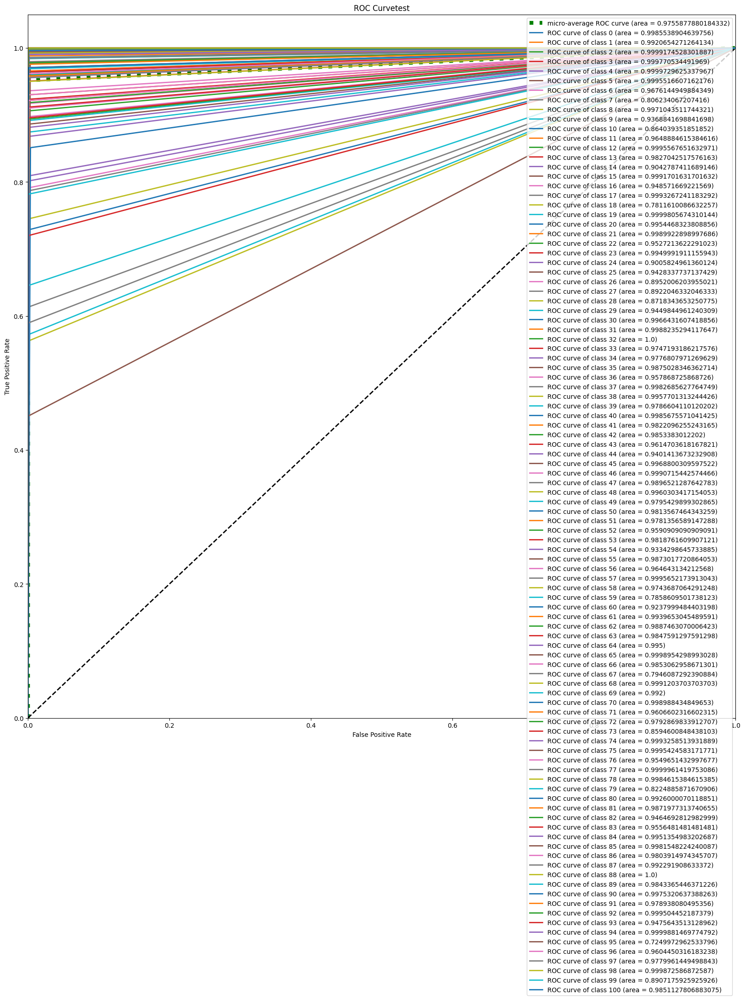

In [31]:
plot_roc('metrics_resnet_tuned.pth')

### 2.5 Візуалізуємо AUC-PRC plot, що представляє собою площу під кривою Precision-Recall, що відображає зв'язок між точністю і відгукмо для різних порогів класифікації, відповідно що більше значення AUC-PRC, тим краще працює класифікатор. Застосуємо цю візуалізацію для усіх начених моделей

In [32]:
def plot_auc_prc(input_file_path):
    results = torch.load(input_file_path)
    for oper in ['train', 'test']:
        test_predicted = torch.tensor(results['test_predicted']).numpy()
        test_target = torch.tensor(results['test_target']).numpy()

        test_target_bin = label_binarize(test_target, classes=range(len(set(test_target))))
        test_predicted_bin = label_binarize(test_predicted, classes=range(len(set(test_target))))

        precision = dict()
        recall = dict()
        average_precision = dict()

        for i in range(len(set(test_target))):
            precision[i], recall[i], _ = precision_recall_curve(test_target_bin[:, i], test_predicted_bin[:, i])
            average_precision[i] = average_precision_score(test_target_bin[:, i], test_predicted_bin[:, i])

        precision["micro"], recall["micro"], _ = precision_recall_curve(test_target_bin.ravel(), test_predicted_bin.ravel())
        average_precision["micro"] = average_precision_score(test_target_bin, test_predicted_bin, average="micro")

        plt.figure(figsize=(30, 25))
        plt.plot(recall["micro"], precision["micro"], label=f'micro-average PR curve (area = {average_precision["micro"]})', color='red', linestyle=':', linewidth=6)

        for i in range(len(set(test_target))):
            plt.plot(recall[i], precision[i], lw=2, label=f'PR curve of class {i} (area = {average_precision[i]})')

        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Precision-Recall Curve' + oper)
        plt.legend(loc="best")
        plt.show()

###  AUC-PRC plot для CNN з 3ма шарами

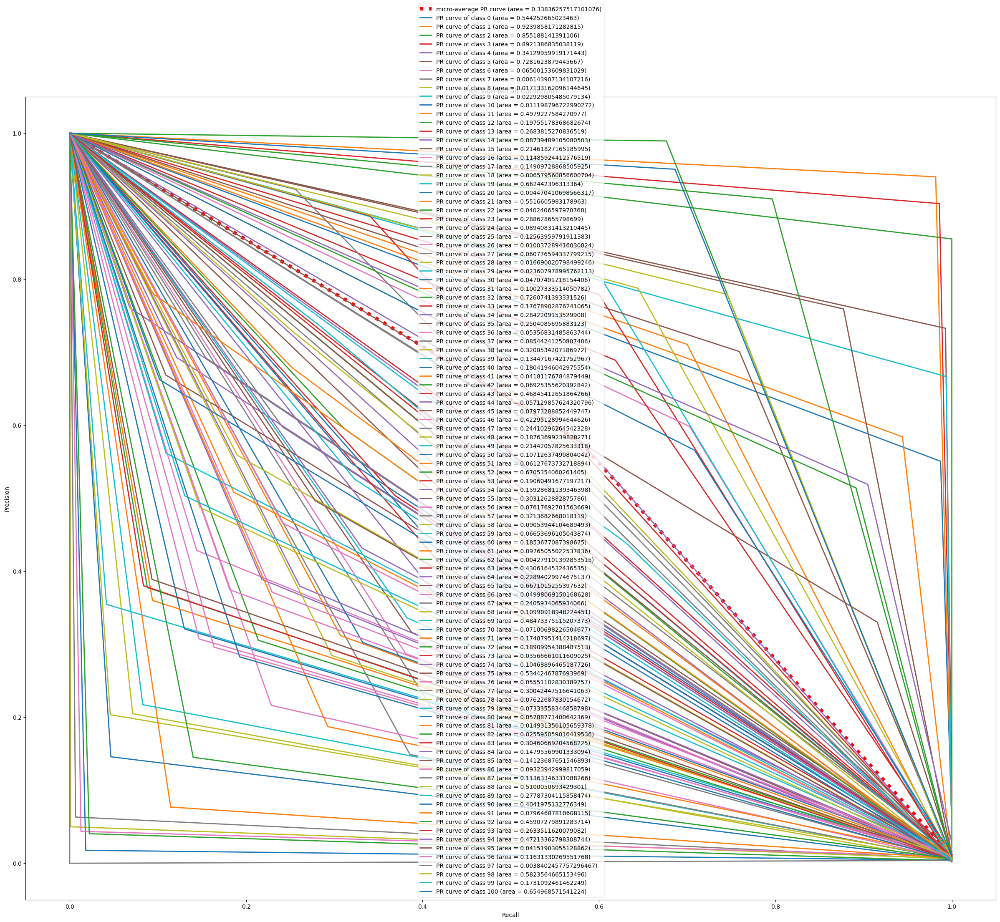

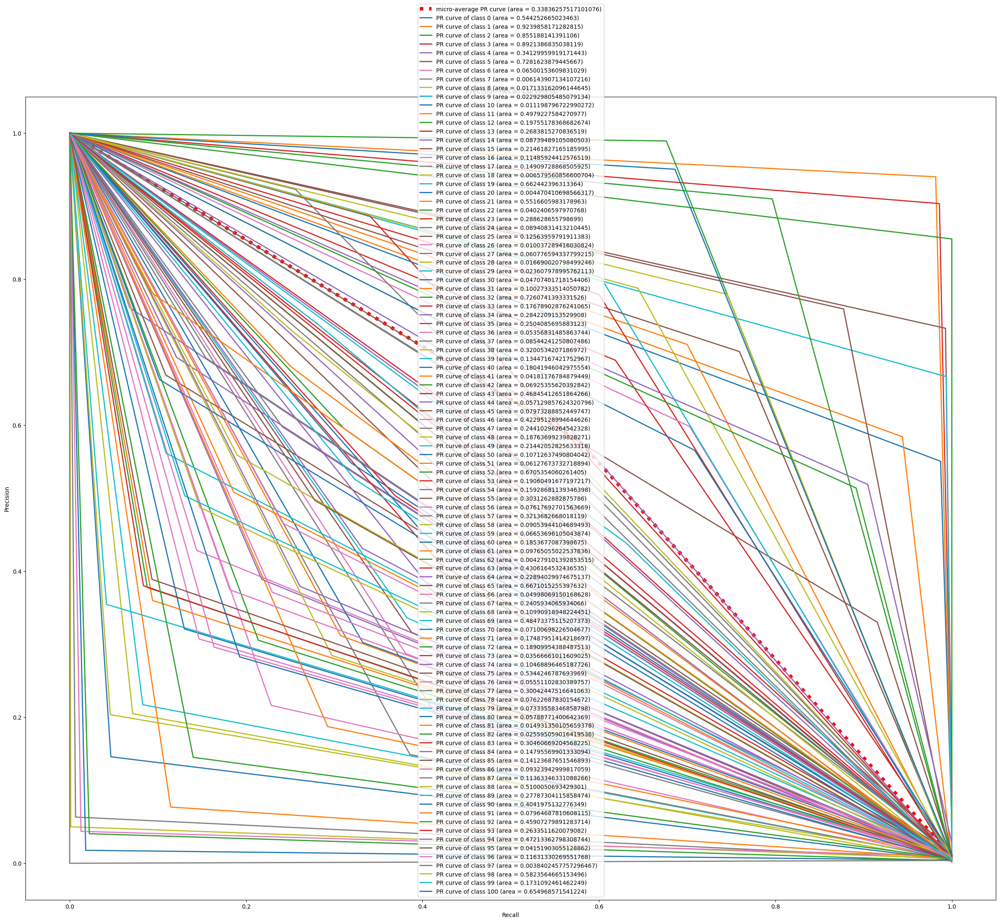

In [33]:
plot_auc_prc('metricsCNN.pth')


###  AUC-PRC plot для Frozen Resnet

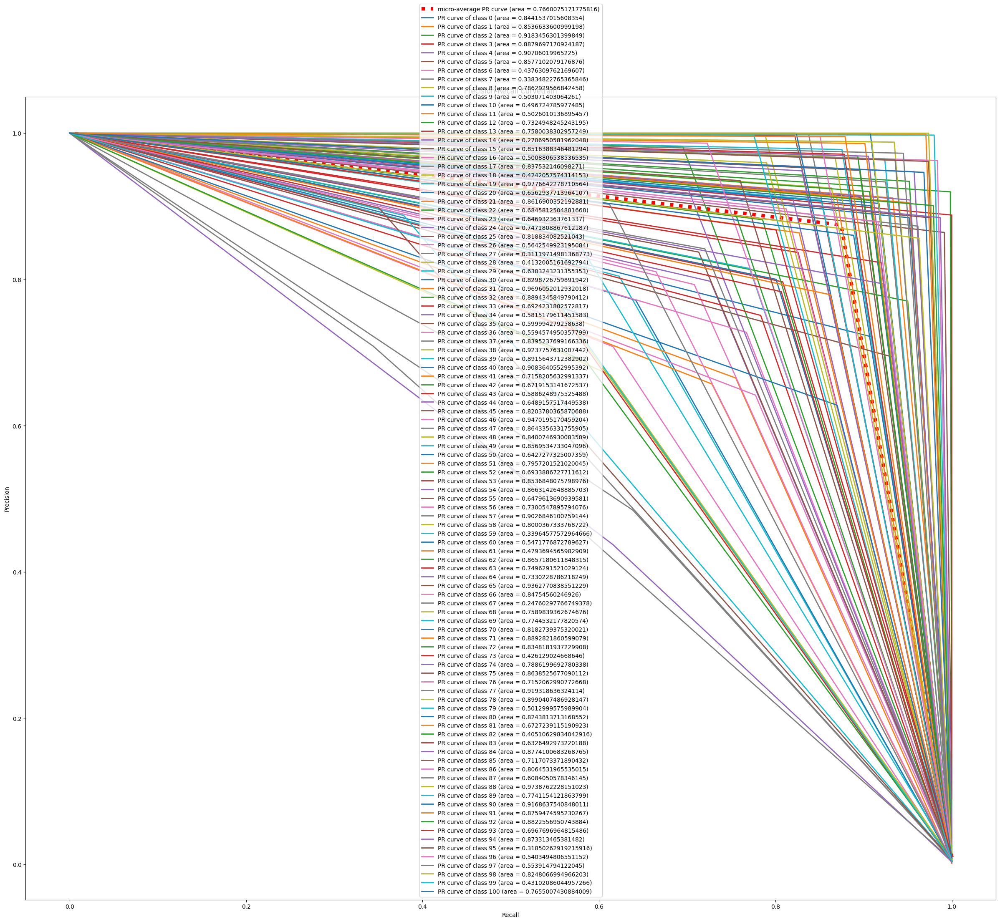

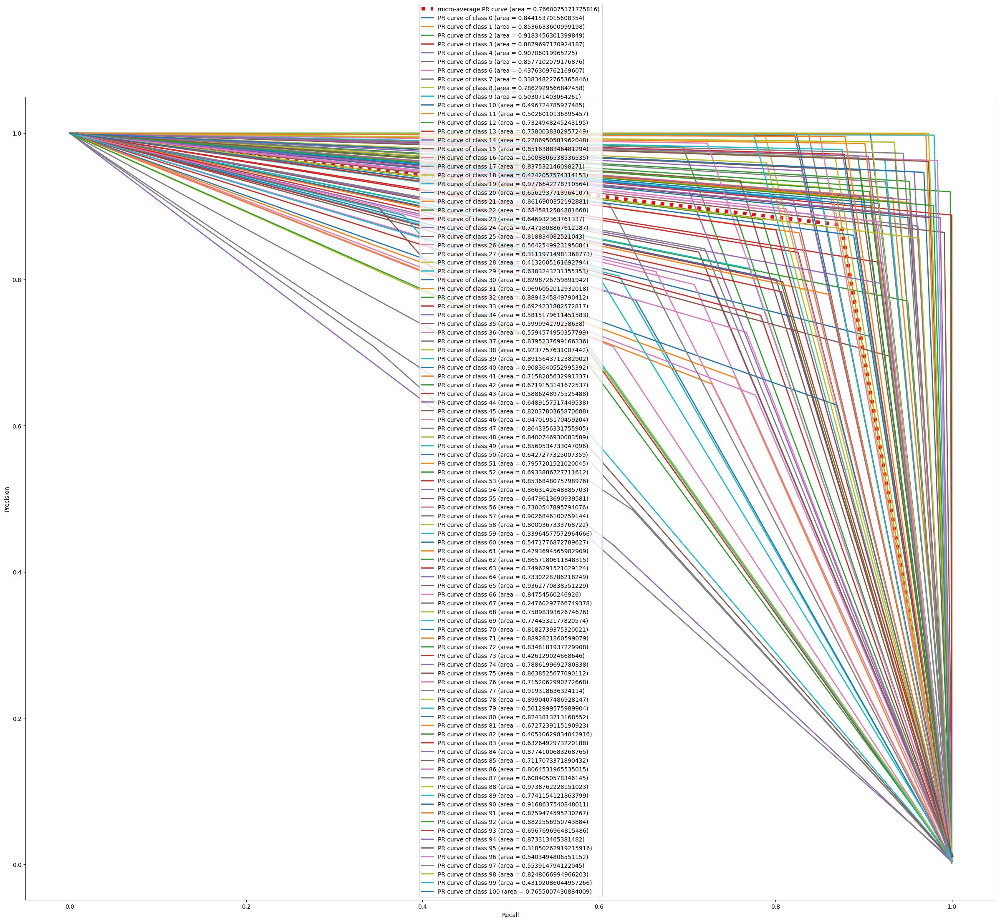

In [34]:
plot_auc_prc('metrics_resnet_frozen.pth')

###  AUC-PRC plot для Fine-Tuned Resnet

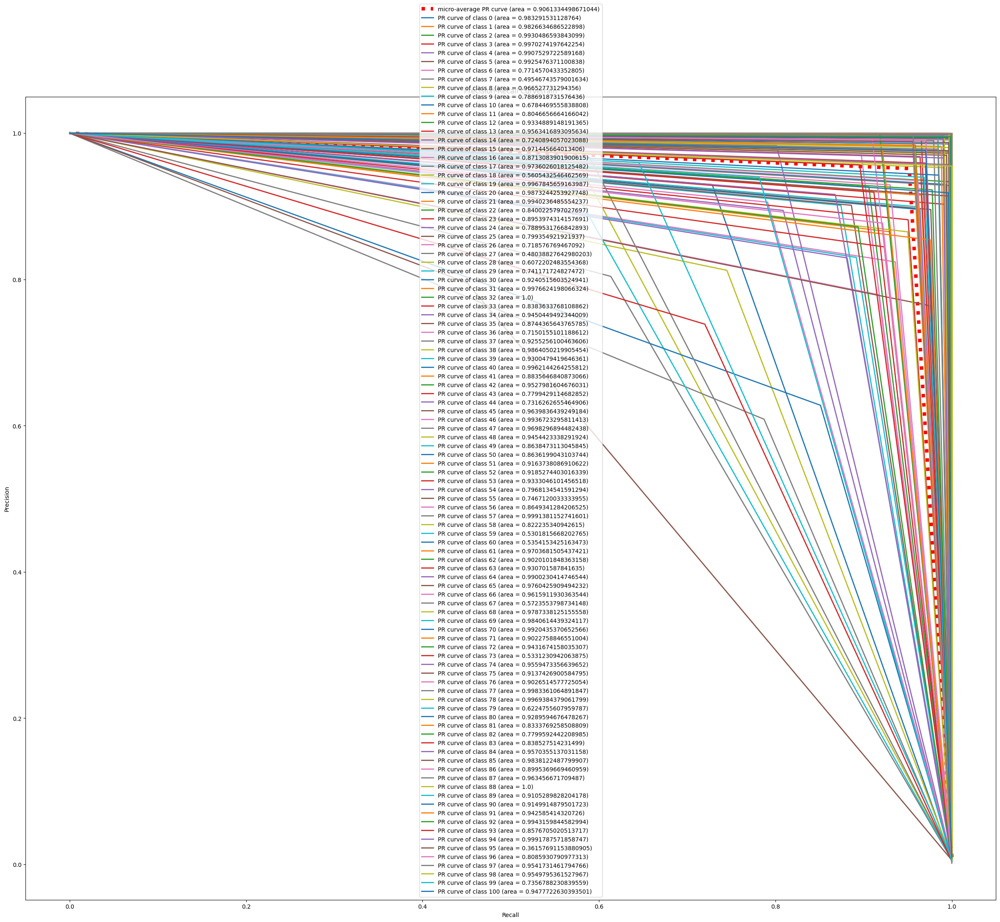

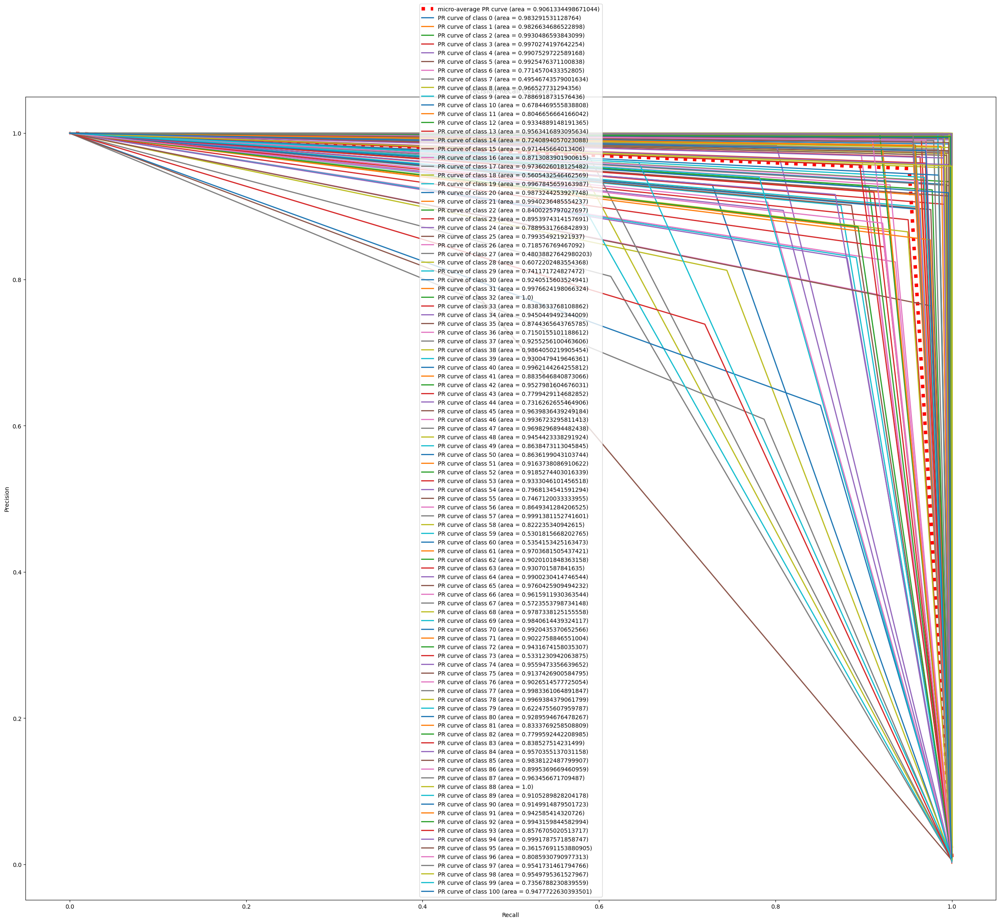

In [35]:
plot_auc_prc('metrics_resnet_tuned.pth')

### 2.6 Обрахуємо значення Top-1 Error Rate для кожної з  моделей. В свою чергу Top-1 Error Rate представляє із себе, відсоток об'єктів, які були неправильно класифіковані моделлю за першим найбільш ймовірним класом.

In [36]:
def get_top_error(file_path):
    metrics = torch.load(file_path)
    print('Top-1 Error Rate:', 100 * (1 - metrics['test_accuracies'][-1]), '%')

In [37]:
get_top_error('metricsCNN.pth')
get_top_error('metrics_resnet_frozen.pth')
get_top_error('metrics_resnet_tuned.pth')

Top-1 Error Rate: 42.19124423963133 %
Top-1 Error Rate: 12.549155145929337 %
Top-1 Error Rate: 4.834101382488476 %


### Із усіх отриманих метрик та візуалізацій бачимо, що по всіх характеристика найкращі результати видає Fine-Tuned Resnet

### Частина 3 - Візулаізація фільтрів та фіч

### У даній чатині роботи виведимо, які саме фільтри розміром 3x3 застосовувалися на конувлюційні шари під час тестування, та як від цього змінювалося зображення при виділенні основних фого фіч у кожному з каналів RGB

In [38]:
def plot_filters_and_feature_maps(model_name, model, testloader, device):
    images, labels = next(iter(testloader))
    images = images.to(device)
    idx = 3
    img = images[idx].cpu().permute(1, 2, 0).numpy()

    plt.imshow(img)
    plt.axis('off')
    plt.show()

    if model_name == 'CNN':
        conv_layers = [model.conv1, model.conv2]
    elif model_name in ['freezed', 'tuned']:
        conv_layers = [model.layer1[0].conv1, model.layer2[0].conv1]

    for conv_layer in conv_layers:
        weights = conv_layer.weight.data.cpu().numpy()
        fig = plt.figure(figsize=(40, 30))
        columns = min(10, weights.shape[0])
        rows = 2
        for i in range(0, columns * rows):
            ax = fig.add_subplot(rows, columns, i + 1)
            if i % 2 == 0:
                ax.imshow(weights[i // 2][0])
                ax.axis("off")
                ax.set_title(f"1st layer filter weights {i // 2}")
            else:
                filtered_img = cv2.filter2D(img, -1, weights[(i - 1) // 2][0])
                ax.imshow(cv2.cvtColor(filtered_img, cv2.COLOR_BGR2RGB))
                ax.axis("off")
                ax.set_title(f"Img filtered by {i // 2}")
        fig.suptitle("Resnet weights")
        plt.tight_layout()
        plt.show()

### Отже, при застосуванні функції наведеної вище для моделі 3-шарової CNN, на виході ми отримаємо для оцінки моделі спочатку вивід початкового зображення, після чого по парно виведені для кожного з конвулюційних шарів відповідний фільтр-вага, що застосовується на зображення, та зображення після його застосування у кожному шарів початкового зображення

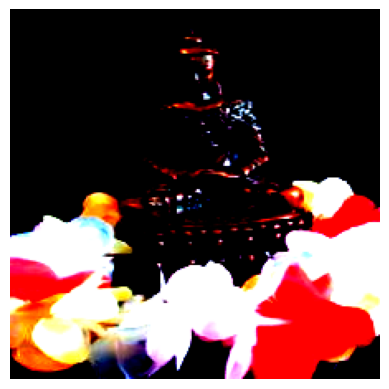

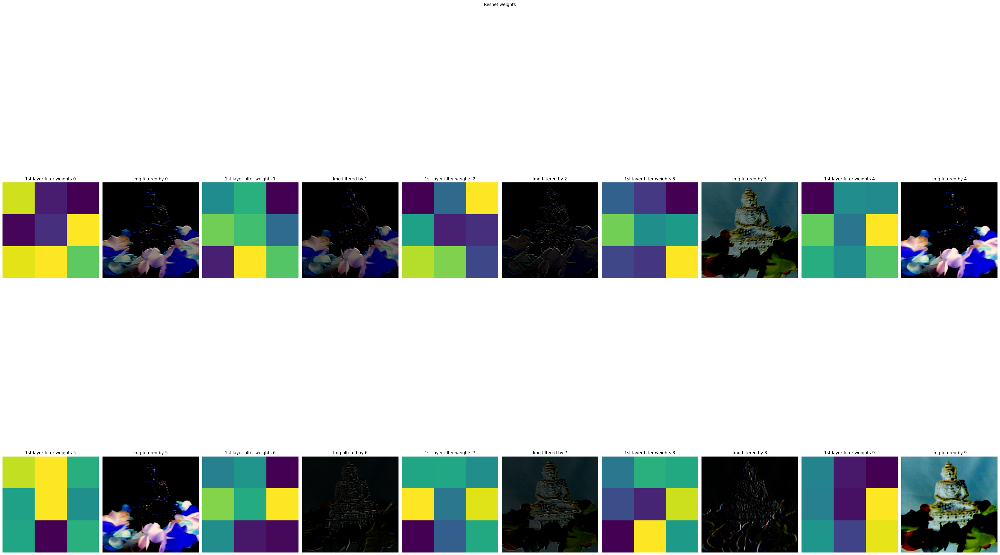

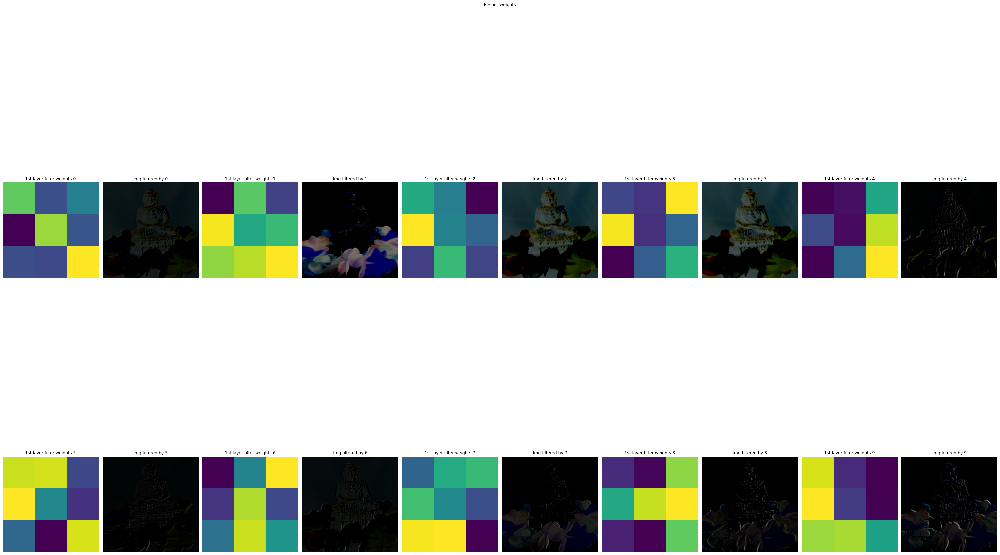

In [39]:
model.eval()
plot_filters_and_feature_maps("CNN", model, testloader, device)

### Виведимо фільри і зображення обробнеі цим фільтром на кожному х шарів для Frozen Resnet

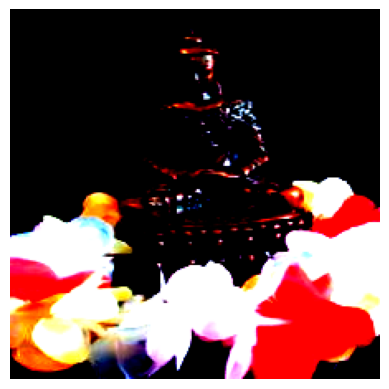

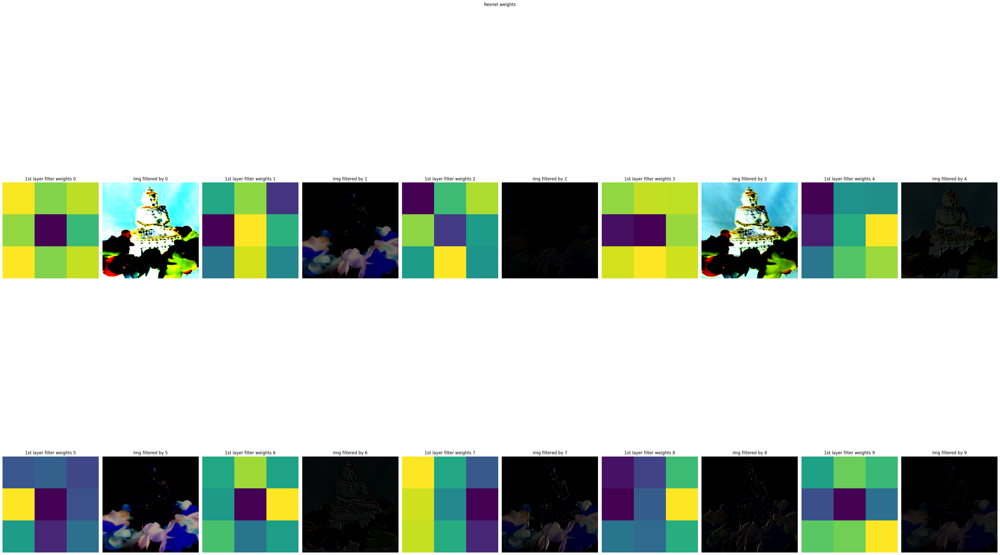

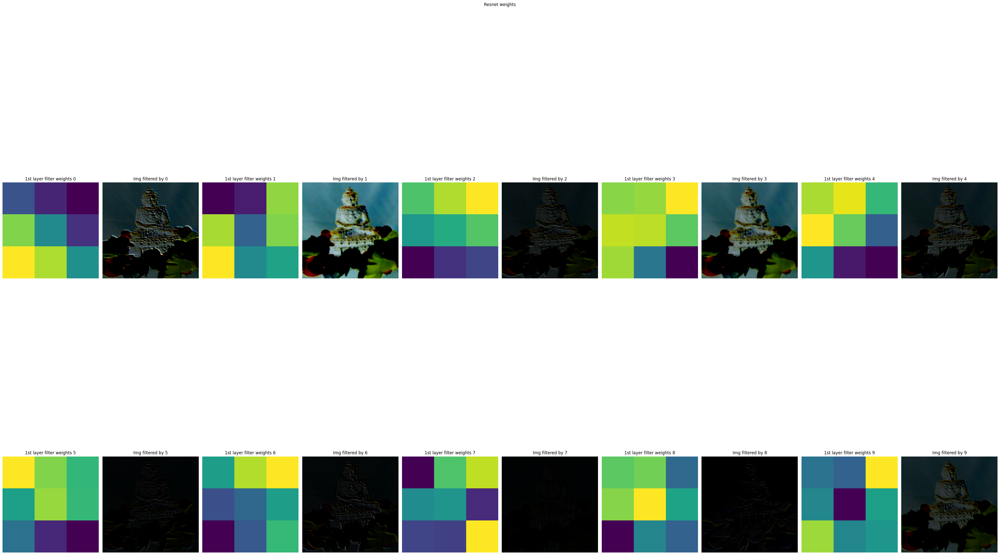

In [40]:
resnet_f = models.resnet18(weights='ResNet18_Weights.DEFAULT')

for param in resnet_f.parameters():
    param.requires_grad = False

num_ftrs = resnet_f.fc.in_features
resnet_f.fc = nn.Linear(num_ftrs, 101)

resnet_f = resnet_f.to(device)
resnet_f.eval()

plot_filters_and_feature_maps("tuned", resnet_f, testloader, device)

### Виведимо фільри і зображення обробнеі цим фільтром на кожному х шарів для Tuned Resnet

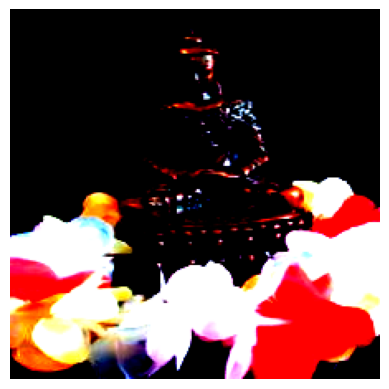

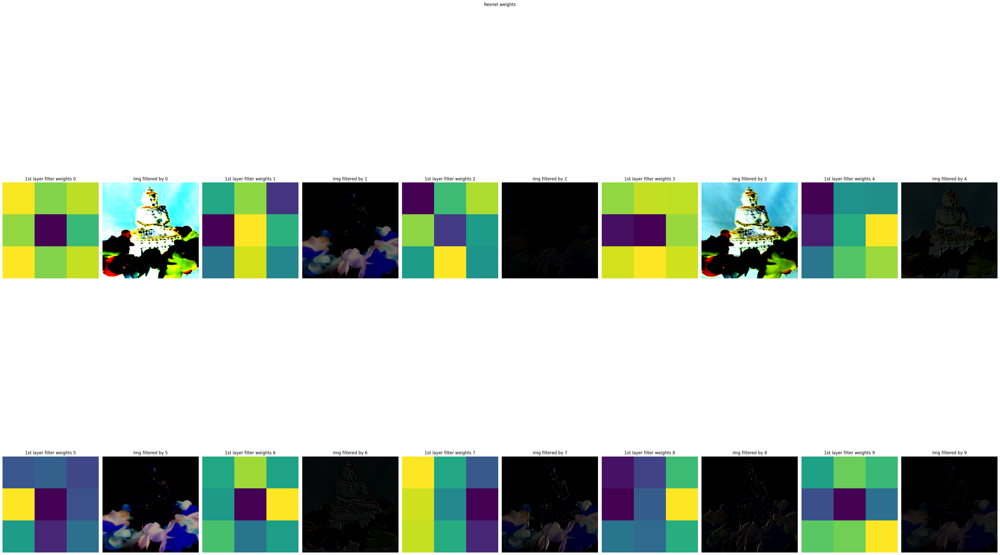

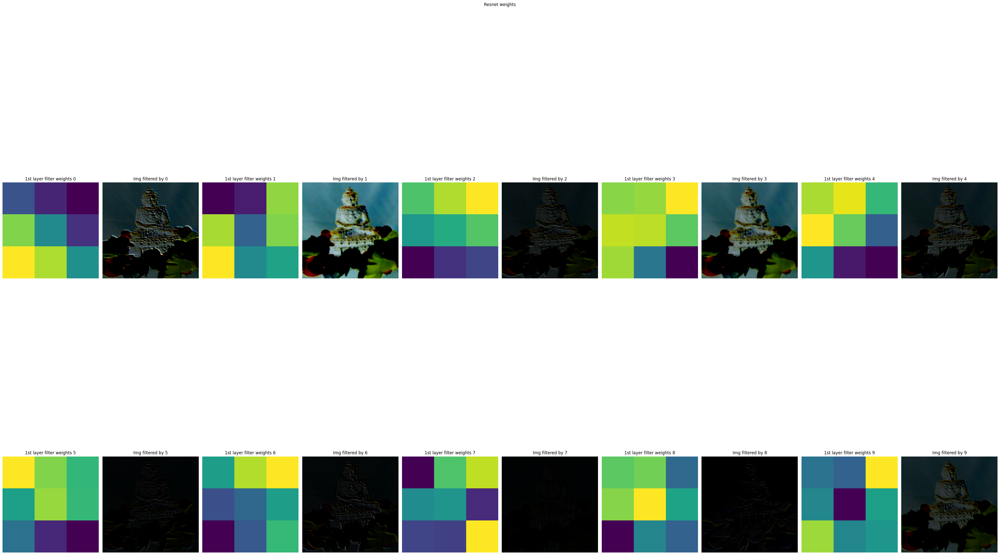

In [41]:
resnet_t = models.resnet18(weights='ResNet18_Weights.DEFAULT')

for param in resnet_t.parameters():
    param.requires_grad = False

num_ftrs = resnet_t.fc.in_features
resnet_t.fc = nn.Linear(num_ftrs, 101)

resnet_t = resnet_t.to(device)
resnet_t.eval()

plot_filters_and_feature_maps("tuned", resnet_t, testloader, device)

### Із отриманих візуалізацй бачимо, що деякі фільтри краще виділяють ознаки в зображень, а деякі гірше, особливо добре це видно якщо порівнювати модель CNN з 3ма шарами та Fine-Tuned Resnet, так деякі з фільтрів, які ще називають сліпими фільтрами, взагалі погіршують зображення, як от повне видалення і зафарбування всього зображення в чорний колір

### Частина 4 - Пояснення результатів/Відповіді на питання



1.   Із отриманих результатів візуалізації фільтрів для моделі CNN, що застосовуються на зображення, бачимо що в основному ці фільтри при покращенні значень ваг намагаються більше виділяти конутри(прямі та криві) об'єктів зображеннях(в даному випадку об'єкт це силует статуї), і відповідно в залежності від фільтра деякі контури виділяються сильніше, а деякі слабше як от наприклад при застосуванні горизонтального фільтру всі контури по горизонталі краще виділяються ніж по вертикалі і навпаки.

2. Під час навчання моделі і обнови ваг для фільтрів, деякі фільтри для моделі до прикладу Frozen Resnet є сліпими, так 3тє зображення в 4му рядку, має найбільш виражений вплив сліпих фільтрів, які повністю перетворили зображення в чорний колір, відповідно ніякої корисної інформації модель не може дістати про силует статуї що знаходиться на ньому для класифікації. Це спричинено тим, що модель перенавчається на тренувальних даних і створює фільтри, які виділяють усі ознаки для конкретних фотографій, а в свою чергу на тестові зображення про які модель нічого не знає, такі сліпі фільтри спричиняють повну втарту інформації про об'єкт на ньому. Аби уникнути цієї проблеми можна застосовувати Batch нормалізацію шарів, що бориться з перенавчанням, проте даний шар нормалізації лише частково бориться з перенавчанням, найкраще для того аби не виникало перенавчання змінювати архітектуру CNN мережі, що має найбільший вплив на модель. Також існує і третій варіант боротьби з сліпими фільтрами, під назвою Feature Map Visualization, що відображає значення фільтрів і зображень, та відповідно дає змогу краще роузміти коли починається перенавчання, та де краще змінювати значення параметрів архітектури моделі, як от розмір фільтра чи виділення основних фіч через MaxPool та інше.

3. В даному випадку, модель CNN має лише 3 шари, і не здатна відділяти об'єкт повінсю від його фону. Так до прикладу, якщо подивитися на перший рядок на 5 зображення то можемо побачити, що при застосуванні фільтра виділилася не лише статуя, але і її фон. Що звісно впливає на процес навчання моделі і класфікацію об'єкта відповідно. Проте, якщо порівняти зображення з тими ж об'єктами для першого рядка Fine-Tuned Resnet то можемо побачити, що хоч і на початкових значеннямх ваг присутні фони, то поступово вони повністю зникають і залишається лише виділений силует статуї, що обумовлено тим, що Tuned Resnet має складнішу архітектуру ніж модель з 3ма шарами CNN, тому для боротьби із виділенням об'єкта окремо від фону, потрібно ускладнювати модель.

4. Під час навчання моделі, і перед тим як подавати тензори їй на вхід самі зображення проходять препроцесінг, так оскільки деякі з зображень були чорно-білими 1-канальними, що могло вплинути на навчання моделі і її вміння виділяти конутри на зобарженні то перед цим для усіх вхідних зображень було переведення у формат RGB при перетворенні у тензор, з подальшою нормалізацією та стандартизацією даних, для того аби стабілізувати навчання моделі. Тому під час навчання моделі кожен конвулюційний шар мережі враховує інформацію із значень каналів RGB.



### Частина 5 - Покращене тренування моделі Fine-Tuned Resnet для досягнення average accuracy ≥ 91% та top-1 error rate < 15% на тестових даних

In [42]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Обрахуємо для натринованої вже раніше моделі Fine-Tuned Resnet top-1 score

In [43]:
get_top_error('metrics_resnet_tuned.pth')

Top-1 Error Rate: 4.834101382488476 %


Напишимо нову функцію обрахунку avarage accuracy, яка рахується як середнє арифмитична

In [44]:
metrics = torch.load('metrics_resnet_tuned.pth')
conf_matrix = confusion_matrix(metrics['test_target'], metrics['test_predicted'])
accuracy_per_class = conf_matrix.diagonal()/conf_matrix.sum(axis=1)
avg_acc = 0
for i, acc in enumerate(accuracy_per_class):
    avg_acc += acc

print("Average accuarcy is", avg_acc / 101 * 100, '%')


Average accuarcy is 92.71548260013451 %


### Як бачимо обидві метрики для Fine-Tuned Resnet моделі, краще задовільняють вимоги завдання

# **Висновок**
### У процесі виконання лабораторної роботи я, спроектував нейронну мережу CNN із 3ма шарами, та навчив/оцінив її та дві моделі Resnet, і наочно удосотовірився в тому, що архітектура мережі суттєво впливає на точність класифікації та оверфіт моделі, і відповідно із отриманих результатів дійшов висновку, що найкращою моделлю для даного набору з 8677 фотографій та 101 класом із усіх 3ох наведених є Fine-Tuned Resnet, що дає точність класифікації на тестових даних в найкращому випадку 95% і не має оверфіту моделі, а в свою чергу модель Frozen Resnet має 88% accuracy, а модель CNN 58% і крім цього додатково CNN має ще й оверфіт тренувальних даних, що зумовлено архітектурою моделі.

### Окрім цього дослідив метрики оцінки точності і якості класифікації даних моделей. Дослідив вплив фільтрів-ваг на виділення ознак об'єктів в моделі таки як клас силует статуї, та наочно переконався в тому, що чим кращий фільтр тим ліпше він виділяє контури об'єкта класифікації та забирає надлишкові фонові пікселі, які погіршують якість виділення ознак моделлю під час навчання.





---

<div align="left">
    <h4><b>Виконав:</b></h4>
    <h4>студент</h4>
    <h4>Орлянський Максим</h4>
    <h4><b>Група:</b></h4>
    <h4>КН-317</h4>
    <h4><b>Прийняв:</b></h4>
    <h4>асистент</h4>
    <h4>Гурбич О.В.</h4>
</div>